<a href="https://colab.research.google.com/github/SuvorkinPavel/image-recognition/blob/main/Image_recognition_Lab_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Распознавание образов
## Лабораторная работа № 1
## Выполнил студент группы М19-ИВТ-3
## Суворкин Павел
## 16.10.2020

---



#Image recognition
##Laboratory work №1
##Performed by a student of the M19-IVT-3 group
## Suvorkin Pavel
##16/10/2020

In [50]:
# This block consists of nesessary libraries and frameworks
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
from IPython.display import Image, display

scale = 50 #Image scale

In [51]:
# Mounting google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [52]:
# we need to check out if directories exists and create if not
def create_dirs():
  if os.path.exists('/content/drive/My Drive/Image recognition'):
    print("Image recognition directory exists!")
  else:  
    os.mkdir('/content/drive/My Drive/Image recognition')
    print("Image recognition directory has been created!")

  if os.path.exists('/content/drive/My Drive/Image recognition/Lab_1'):
    print("Lab_1 directory exists!")
  else:
    os.mkdir('/content/drive/My Drive/Image recognition/Lab_1')
    print("Lab_1 directory has been created!")

In [53]:
# creating nesessary dirs
create_dirs()

Image recognition directory exists!
Lab_1 directory exists!


In [54]:
# image path
img_native = "/content/drive/My Drive/Image recognition/Lab_1/40k.jpeg"
img_process = "/content/drive/My Drive/Image recognition/Lab_1/"

## All functions

In [55]:
# the function of increasing the brightness of the image. by default, K = 30
def increase_brightness(img, value=30):
    rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    r, g, b = cv2.split(rgb)
    if value > 0:
        lim = 255 - value
        r[r > lim] = 255
        r[r < lim] += value
        g[g > lim] = 255
        g[g < lim] += value
        b[b > lim] = 255
        b[b < lim] += value
    else:
        value = abs(value)
        r[r > value] -= value
        r[r < value] = 0
        g[g > value] -= value
        g[g < value] = 0
        b[b > value] -= value
        b[b < value] = 0
    final_rgb = cv2.merge((r, g, b))
    img = cv2.cvtColor(final_rgb, cv2.COLOR_RGB2BGR)
    return img

In [56]:
# Image invert function (full negative)
def full_invert(img):
    rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    r, g, b = cv2.split(rgb)
    for i in range(len(r)):
        r[i] = 255 - r[i]
        g[i] = 255 - g[i]
        b[i] = 255 - b[i]
    final_rgb = cv2.merge((r, g, b))
    img = cv2.cvtColor(final_rgb, cv2.COLOR_RGB2BGR)
    return img

In [57]:
# Image invert function (partial upper negative)
def upper_invert(img, value):
    rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    r, g, b = cv2.split(rgb)
    for i in range(len(r)):
        for j in range(len(r[i])):
            v = (r[i][j] + g[i][j] + b[i][j]) / 3
            if v > value:
                r[i][j] = 255 - r[i][j]
                g[i][j] = 255 - g[i][j]
                b[i][j] = 255 - b[i][j]
    final_rgb = cv2.merge((r, g, b))
    img = cv2.cvtColor(final_rgb, cv2.COLOR_RGB2BGR)
    return img

In [58]:
# Image invert function (partial lower negative)
def lower_invert(img, value):
    rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    r, g, b = cv2.split(rgb)
    for i in range(len(r)):
        for j in range(len(r[i])):
            v = (r[i][j] + g[i][j] + b[i][j]) / 3
            if v < value:
                r[i][j] = 255 - r[i][j]
                g[i][j] = 255 - g[i][j]
                b[i][j] = 255 - b[i][j]
    final_rgb = cv2.merge((r, g, b))
    img = cv2.cvtColor(final_rgb, cv2.COLOR_RGB2BGR)
    return img

In [59]:
# Binary image conversion function
def binary(img):
    grayImage = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    (thresh, blackAndWhiteImage) = cv2.threshold(grayImage, 127, 255, cv2.THRESH_BINARY)
    img = cv2.cvtColor(blackAndWhiteImage, cv2.COLOR_GRAY2BGR)
    return img

In [60]:
# Brightness slice function (upper)
def upper_binary(img, value):
    rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    r, g, b = cv2.split(rgb)
    for i in range(len(r)):
        for j in range(len(r[i])):
            v = (r[i][j] + g[i][j] + b[i][j]) / 3
            if v > value:
                r[i][j] = 255
                g[i][j] = 255
                b[i][j] = 255
    final_rgb = cv2.merge((r, g, b))
    img = cv2.cvtColor(final_rgb, cv2.COLOR_RGB2BGR)
    return img

In [61]:
# Brightness slice function (lower)
def lower_binary(img, value):
    rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    r, g, b = cv2.split(rgb)
    for i in range(len(r)):
        for j in range(len(r[i])):
            v = (r[i][j] + g[i][j] + b[i][j]) / 3
            if v < value:
                r[i][j] = 0
                g[i][j] = 0
                b[i][j] = 0
    final_rgb = cv2.merge((r, g, b))
    img = cv2.cvtColor(final_rgb, cv2.COLOR_RGB2BGR)
    return img

In [62]:
# Image contrast change function
def contrast(img, k):
    rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    r, g, b = cv2.split(rgb)
    mean_r_list = []
    for i in range(len(r)):
        mean_r_list.append(np.mean(r[i]))
    mean_r = np.mean(np.array(mean_r_list))
    mean_g_list = []
    for i in range(len(g)):
        mean_g_list.append(np.mean(g[i]))
    mean_g = np.mean(np.array(mean_g_list))
    mean_b_list = []
    for i in range(len(b)):
        mean_b_list.append(np.mean(b[i]))
    mean_b = np.mean(np.array(mean_b_list))
    for i in range(len(r)):
        for j in range(len(r[i])):
            r_ = k *(r[i][j] - mean_r) + mean_r
            if r_ > 255:
                r[i][j] = 255
            elif r_ < 0:
                r[i][j] = 0
            else:
                r[i][j] = r_
            g_ = k *(g[i][j] - mean_g) + mean_g
            if g_ > 255:
                g[i][j] = 255
            elif g_ < 0:
                g[i][j] = 0
            else:
                g[i][j] = g_
            b_ = k *(b[i][j] - mean_b) + mean_b
            if b_ > 255:
                b[i][j] = 255
            elif b_ < 0:
                b[i][j] = 0
            else:
                b[i][j] = b_
    final_rgb = cv2.merge((r, g, b))
    img = cv2.cvtColor(final_rgb, cv2.COLOR_RGB2BGR)
    return img


In [63]:
# image histogram display function
def show_hist(img):
    hist = cv2.calcHist([img],[2],None,[256],[0,256])
    plt.plot(hist)
    plt.show()

## Experiments

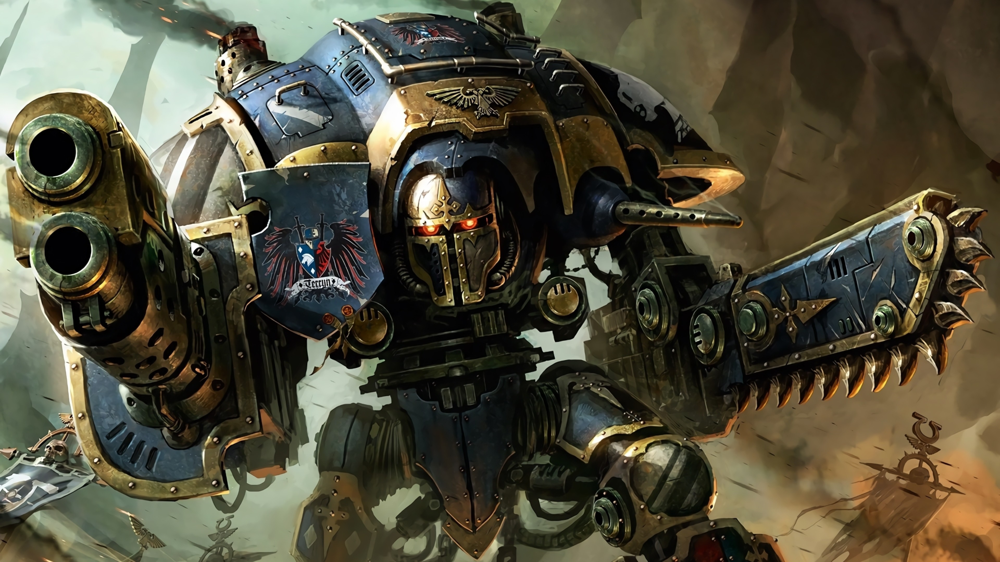

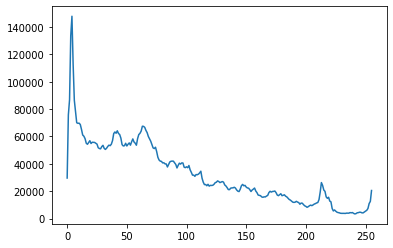

In [64]:
# read image
im = cv2.imread(img_native)
# show image
display(Image(img_native))
# show histogram
show_hist(im)

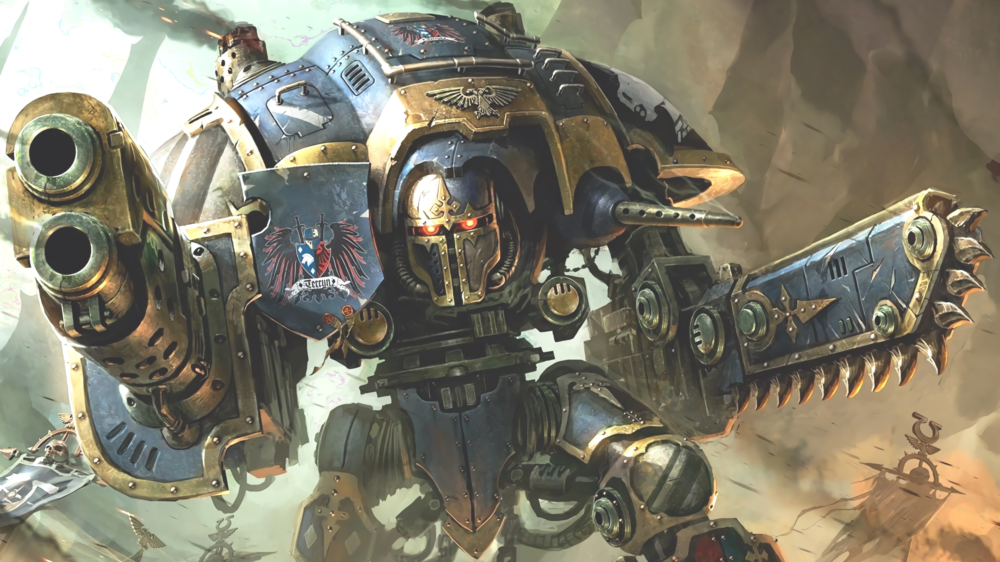

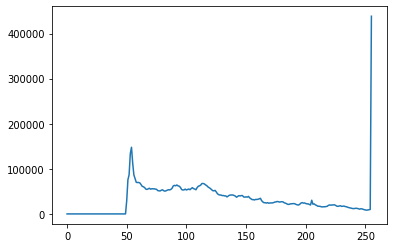

In [65]:
# Increase the brightness of the image. K= 50
frame = increase_brightness(im, value=50)
img_IB = img_process + "40k_1.jpg"
cv2.imwrite(img_IB, frame)
display(Image(img_IB))
show_hist(frame)

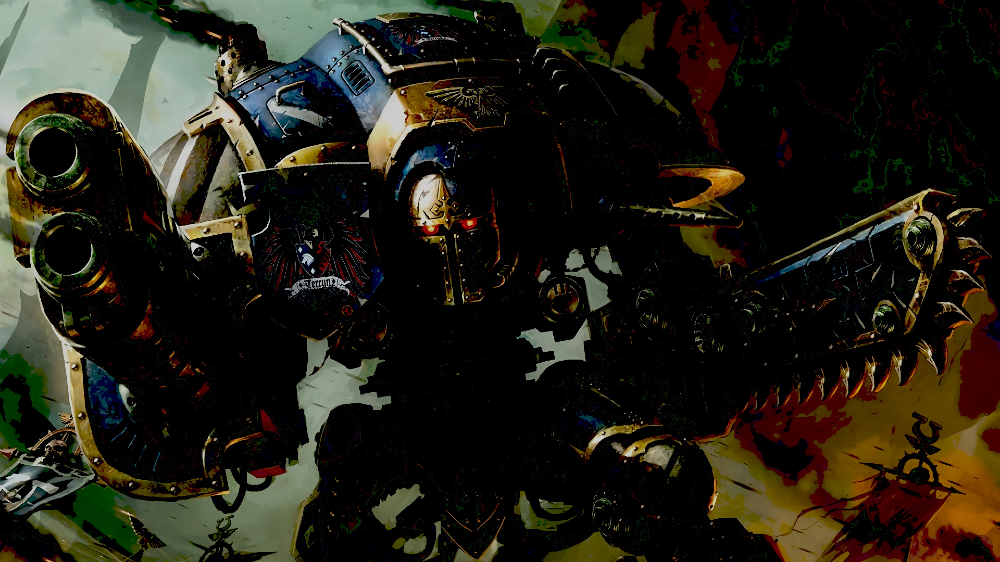

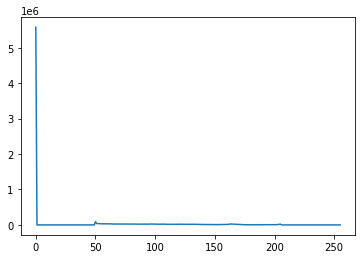

In [66]:
# Reducing the brightness of the image. K= -50
frame = increase_brightness(im, value=-50)
img_DB = img_process + "40k_2.jpg"
cv2.imwrite(img_DB, frame)
display(Image(img_DB))
show_hist(frame)

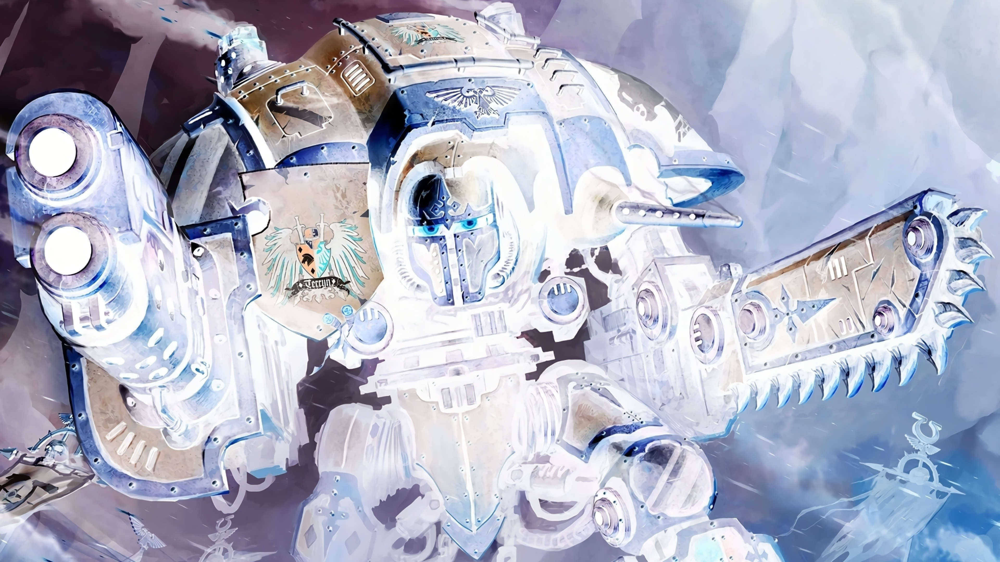

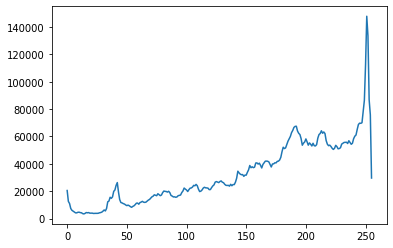

In [67]:
frame = full_invert(im)
img_FI = img_process+"40k_3.jpg"
cv2.imwrite(img_FI, frame)
display(Image(img_FI))
show_hist(frame)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: overflow encountered in ubyte_scalars
  import sys


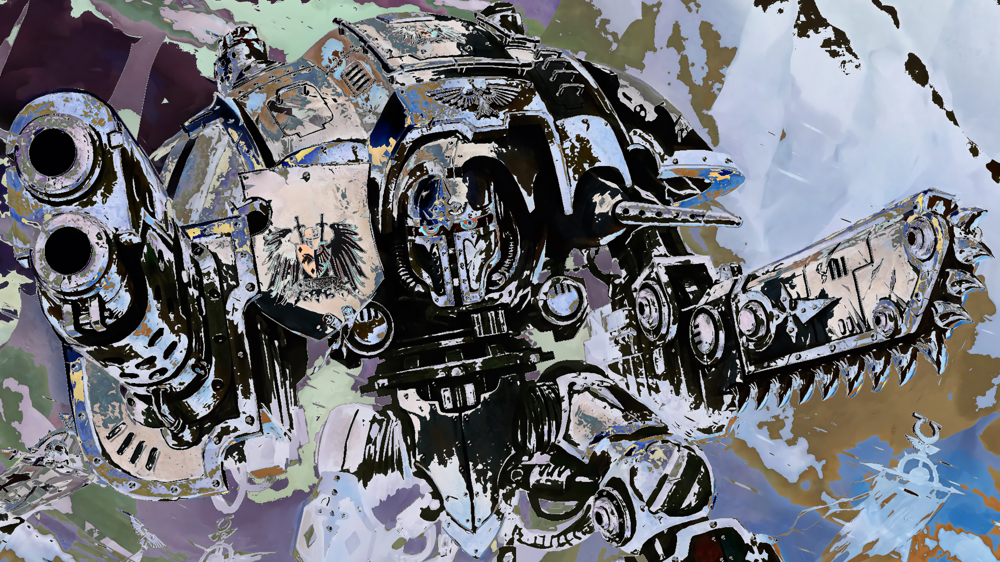

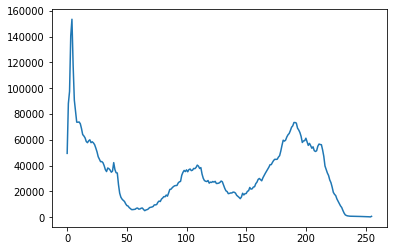

In [68]:
# Inverting the image (partial upper negative)
frame = upper_invert(im, 30)
img_PUN = img_process + "40k_4.jpg"
cv2.imwrite(img_PUN, frame)
display(Image(img_PUN))
show_hist(frame)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: overflow encountered in ubyte_scalars
  import sys


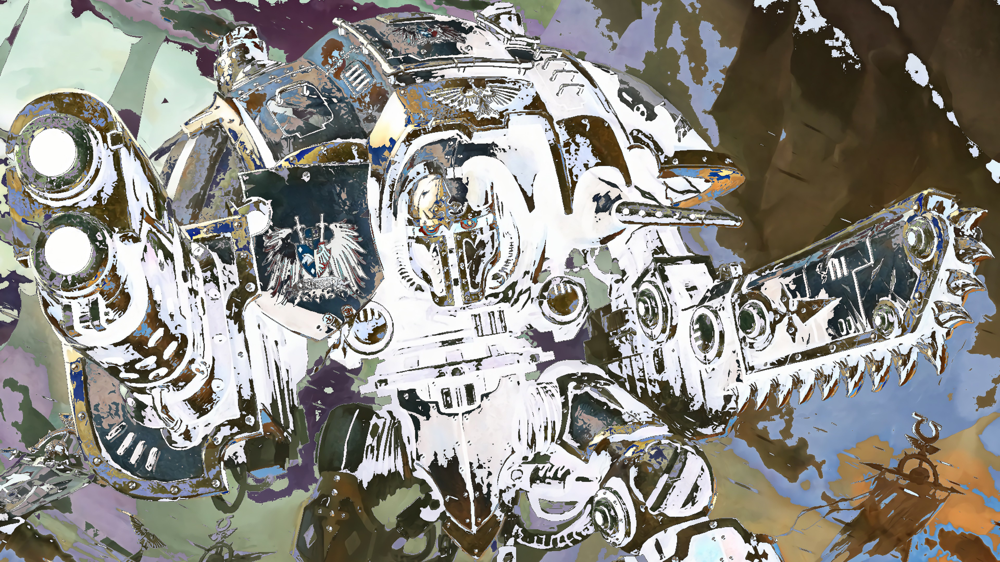

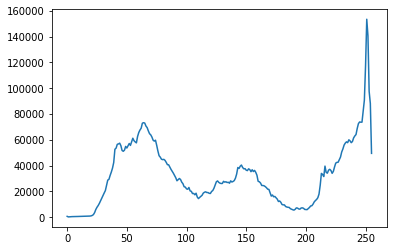

In [69]:
# Inverting the image (partial lower negative)
frame = lower_invert(im, 30)
img_PLN = img_process + "40k_5.jpg"
cv2.imwrite(img_PLN, frame)
display(Image(img_PLN))
show_hist(frame)

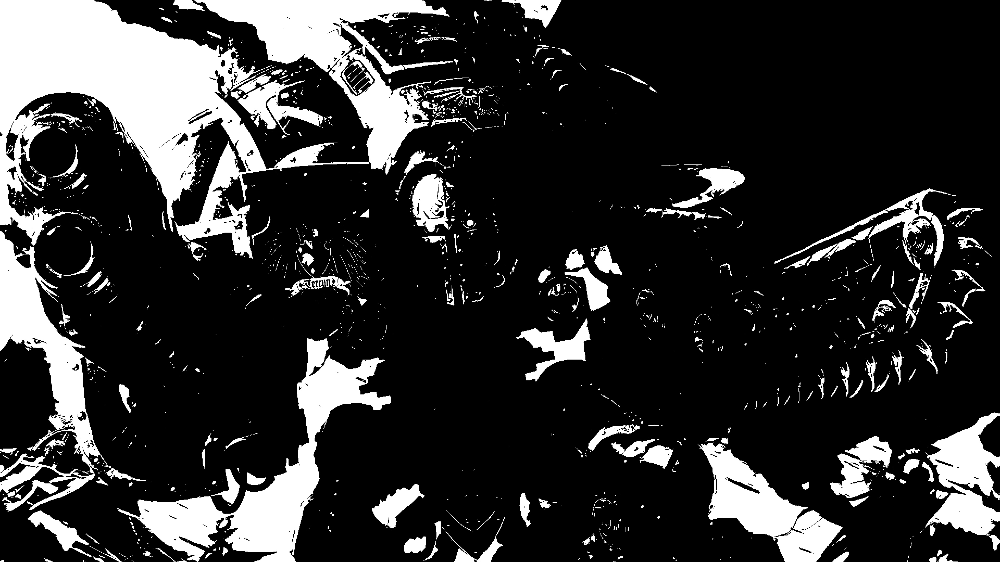

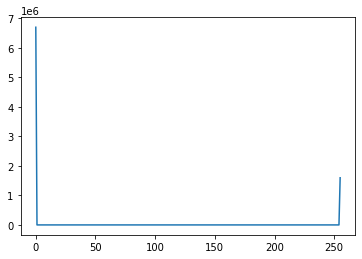

In [70]:
# Converting the source image to binary (bw)
frame = binary(im)
img_BW = img_process + "40k_6.jpg"
cv2.imwrite(img_BW, frame)
display(Image(img_BW))
show_hist(frame)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: overflow encountered in ubyte_scalars
  import sys


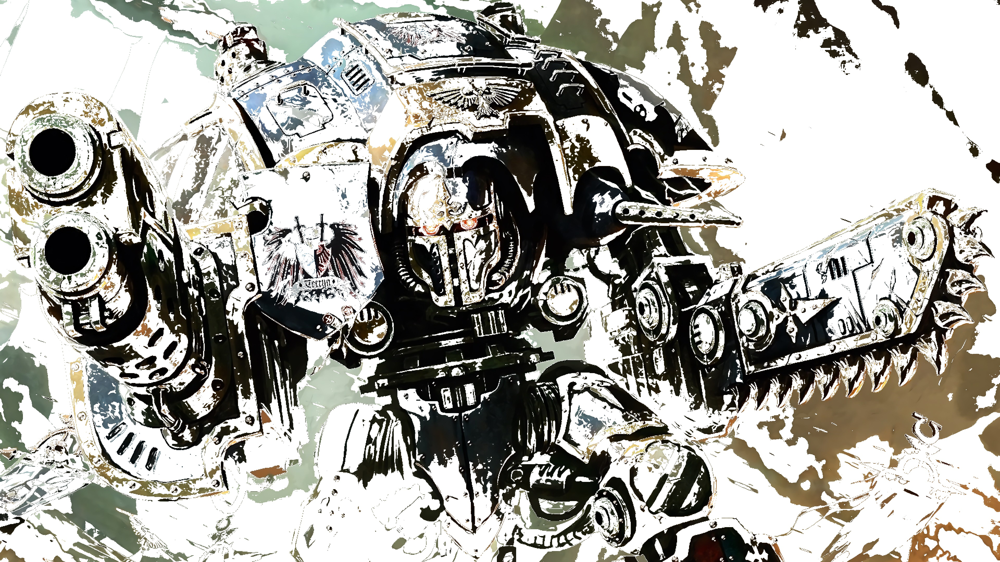

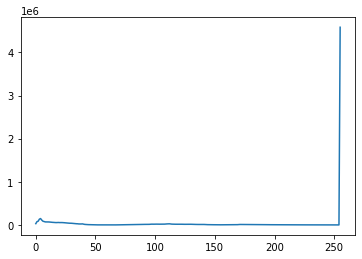

In [71]:
# Brightness slice (top))
frame = upper_binary(im, 30)
img_BST = img_process + "40k_7.jpg"
cv2.imwrite(img_BST, frame)
display(Image(img_BST))
show_hist(frame)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: overflow encountered in ubyte_scalars
  import sys


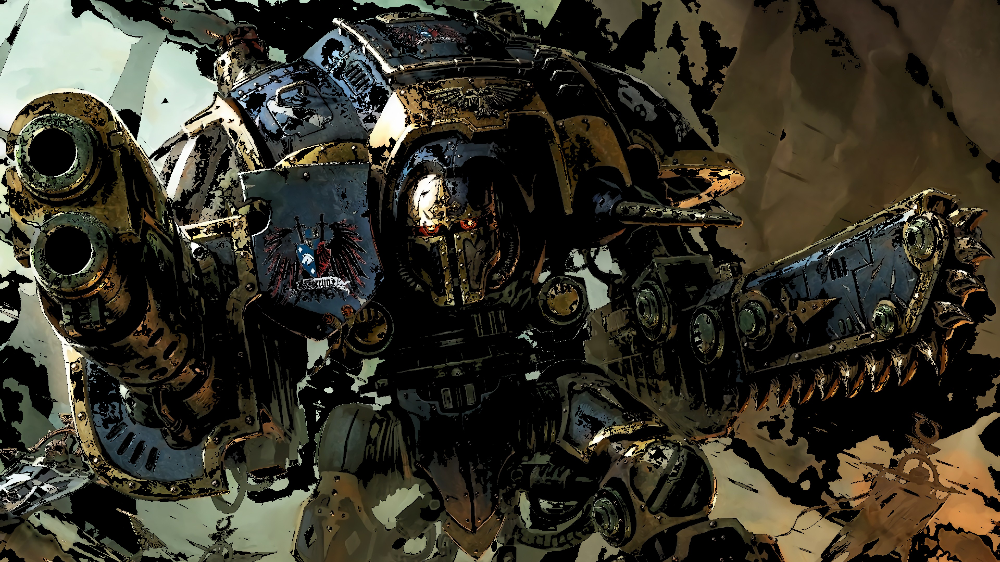

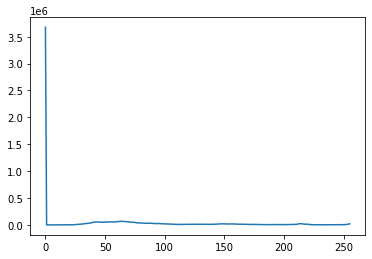

In [72]:
# Brightness slice (lower)
frame = lower_binary(im, 30)
img_BSL = img_process + "40k_8.jpg"
cv2.imwrite(img_BSL, frame)
display(Image(img_BSL))
show_hist(frame)

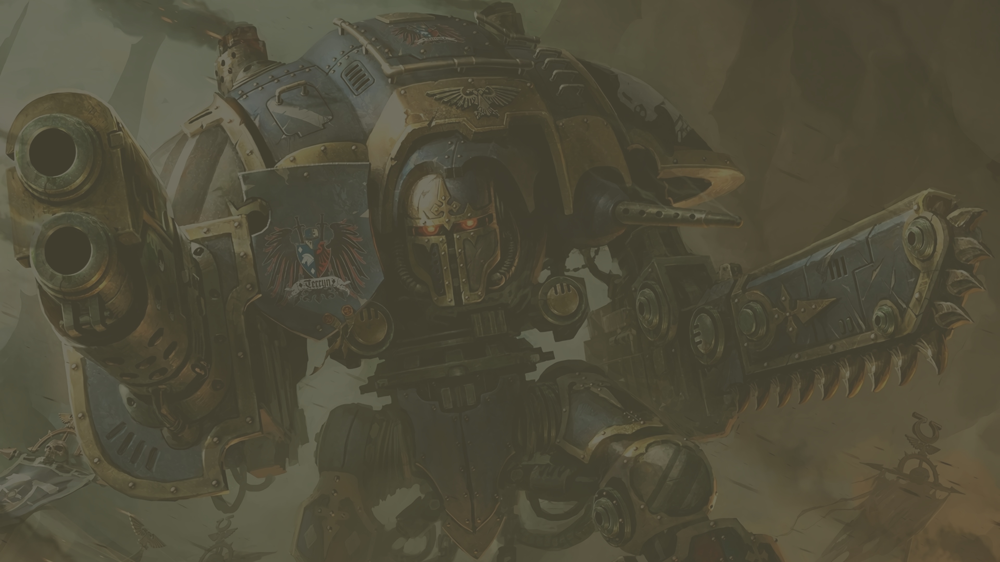

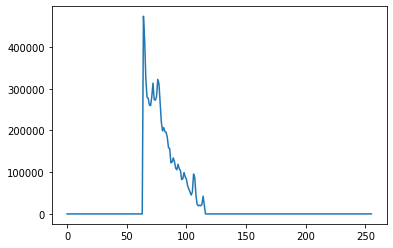

In [73]:
# Change the image contrast K < 1
frame = contrast(im, 0.2)
img_ICM = img_process + "40k_9.jpg"
cv2.imwrite(img_ICM, frame)
display(Image(img_ICM))
show_hist(frame)

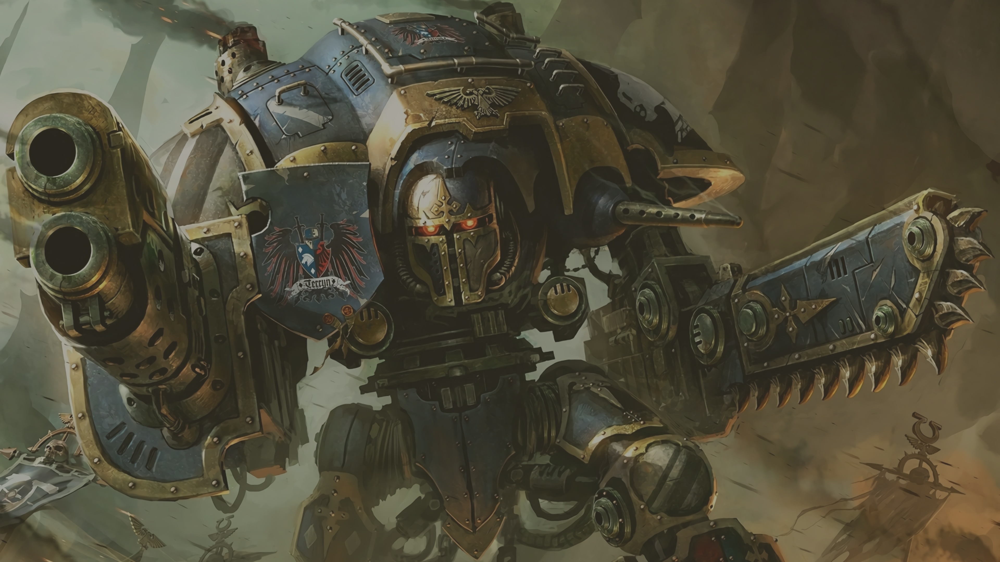

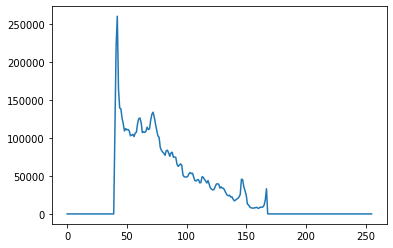

In [75]:
# Change the image contrast to K = 0.5
frame = contrast(im, 0.5)
img_IC05 = img_process + "40k_10.jpg"
cv2.imwrite(img_IC05, frame)
display(Image(img_IC05))
show_hist(frame)

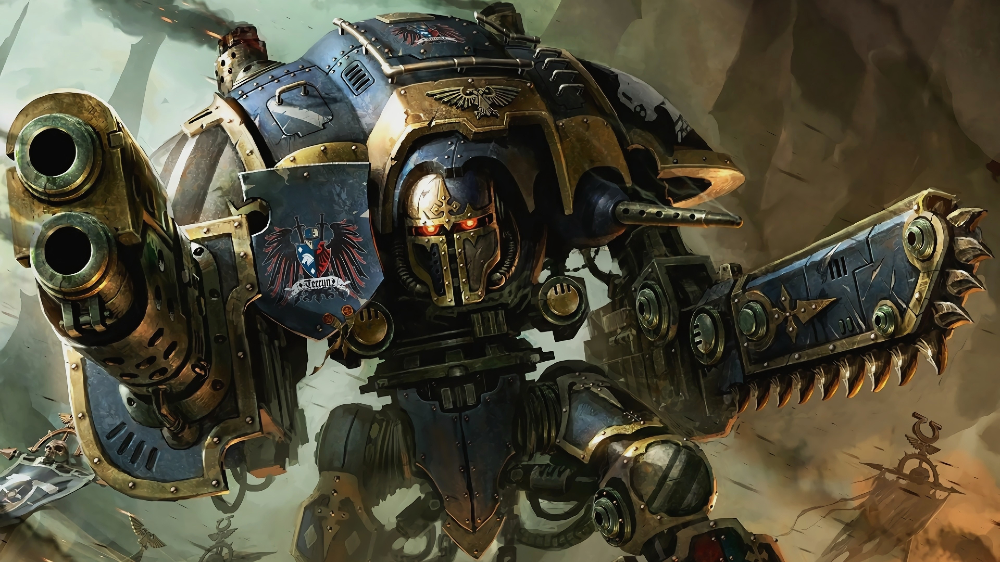

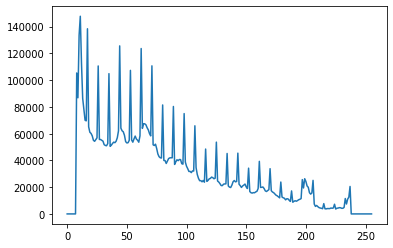

In [77]:
# Image contrast change K = 0.9 (medium contrast)
frame = contrast(im, 0.9)
img_IC09 = img_process + "40k_11.jpg"
cv2.imwrite(img_IC09, frame)
display(Image(img_IC09))
show_hist(frame)

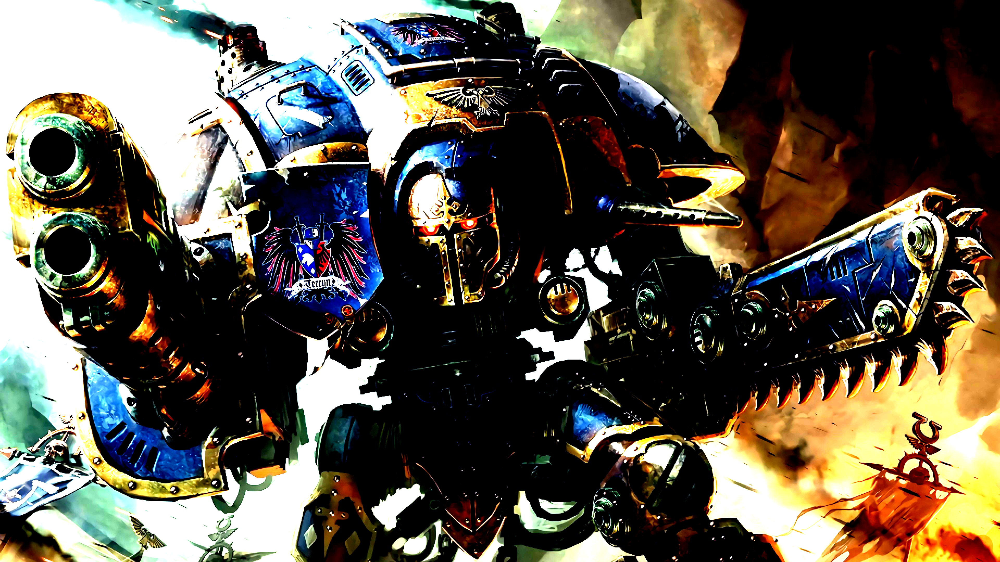

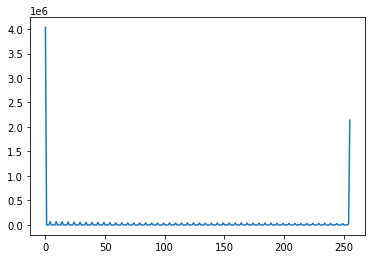

In [78]:
# Change the image contrast To > 1
frame = contrast(im, 5)
img_ICI = img_process + "40k_12.jpg"
cv2.imwrite(img_ICI, frame)
display(Image(img_ICI))
show_hist(frame)